In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata 
import seaborn as sns
from scipy.stats import zscore
import matplotlib.pyplot as plt
import collections

from sklearn.decomposition import PCA
from umap import UMAP

from matplotlib.colors import LinearSegmentedColormap

from scroutines.config_plots import *
from scroutines import powerplots # .config_plots import *
from scroutines import pnmf
from scroutines import basicu


/home/qlyu/mambaforge/envs/bbbroutine/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
outdir_fig = "/scr/qlyu/projects/v1/figures"

In [3]:
adata = anndata.read("../../data/cheng21_cell_scrna/reorganized/all_L23.h5ad")
genes = adata.var.index.values
conds = adata.obs['cond'].values
types = adata.obs['Type'].values
samps = adata.obs['sample'].values
adata

AnnData object with n_obs × n_vars = 41048 × 53801
    obs: 'Class_broad', 'Doublet', 'Doublet Score', 'batch', 'leiden', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'Type', 'Subclass', 'cond'

In [4]:
rename = {
    "L2/3_A": "L2/3_A",
    "L2/3_B": "L2/3_B",
    "L2/3_C": "L2/3_C",
    
    "L2/3_1": "L2/3_A",
    "L2/3_2": "L2/3_B",
    "L2/3_3": "L2/3_C",
    
    "L2/3_AB": "L2/3_A",
    "L2/3_BC": "L2/3_C",
}
adata.obs['easitype'] = adata.obs['Type'].apply(lambda x: rename[x])

In [5]:
# use those 286 genes
# df = pd.read_csv("../../data/cheng21_cell_scrna/res/candidate_genes_vincent_0503_v2.csv")
df = pd.read_csv("../../data/cheng21_cell_scrna/res/L23-ABC-genes-n288-n286unq-annot.csv")
genes_sel = df['gene'].astype(str).values
genes_grp = df['P17on'].astype(str).values
assert len(genes_sel) == len(np.unique(genes_sel))

gi = basicu.get_index_from_array(genes, genes_sel)
assert np.all(genes_sel != -1)

# CP10k for single cells
cov = np.array(adata.X.sum(axis=1))
counts = np.array(adata.X[:,gi].todense())
norm = counts/cov*1e4
lognorm = np.log10(norm+1)
zlognorm = zscore(lognorm, axis=0) 

In [6]:
# zlognorm = np.nan_to_num(zlognorm, 0)

In [7]:
gene_types, gene_type_counts = np.unique(genes_grp, return_counts=True)
gene_types, gene_type_counts

(array(['A', 'B', 'C'], dtype=object), array([122,  35, 129]))

In [8]:
pca = PCA(n_components=50)
pcs = pca.fit_transform(zlognorm)

ucs = UMAP(n_components=2, n_neighbors=50).fit_transform(pcs)

In [9]:
# # fix pc1 to make sure a < c:
# pc1 = pcs[:,0]
# pc_types, unq_types = basicu.group_mean(pc1.reshape(-1,1), types)
# a = pc_types[0,0]
# c = pc_types[-1,0]
# if a > c:
#     pcs[:,0] = -pcs[:,0]

In [10]:
res = pd.DataFrame(pcs, columns=np.char.add("PC", ((1+np.arange(pcs.shape[1])).astype(str))))
res['cond'] = conds
res['type'] = types
res['samp'] = samps
res['umap1'] = ucs[:,0]
res['umap2'] = ucs[:,1]
# res['type'] = types

Text(0, 0.5, 'explained var')

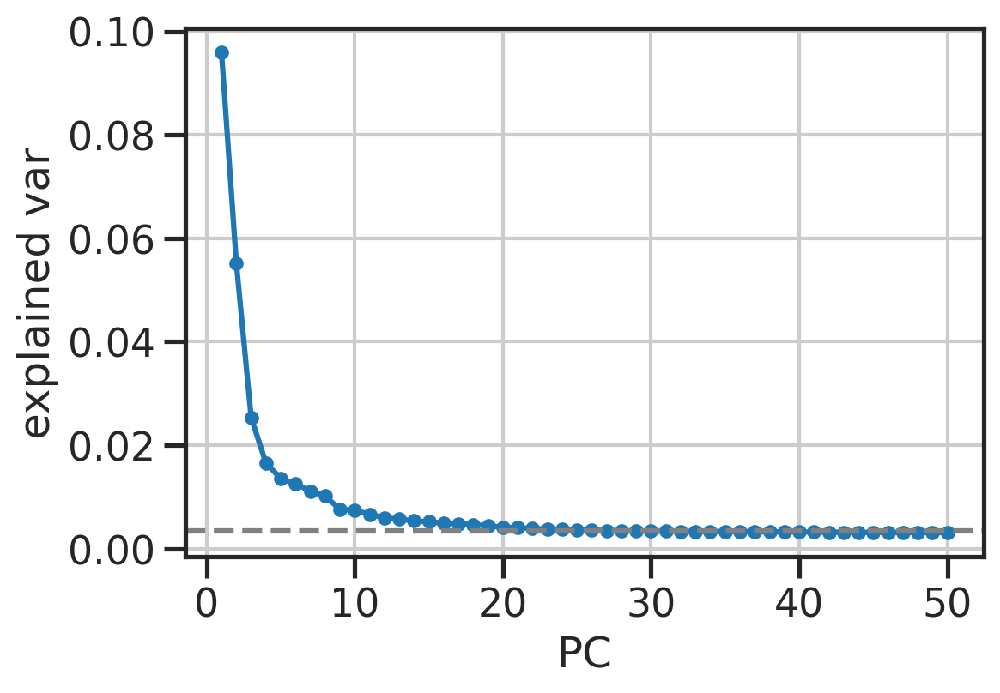

In [11]:
# plt.plot(np.cumsum(pca.explained_variance_ratio_), '-o')
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(np.arange(len(pca.explained_variance_ratio_))+1, pca.explained_variance_ratio_, '-o', markersize=5)
ax.axhline(1/lognorm.shape[1], linestyle='--', color='gray')
ax.set_xlabel('PC')
ax.set_ylabel('explained var')

In [12]:
allcolors = sns.color_palette('tab20c', 20)
allcolors

[(0.19215686274509805, 0.5098039215686274, 0.7411764705882353),
 (0.4196078431372549, 0.6823529411764706, 0.8392156862745098),
 (0.6196078431372549, 0.792156862745098, 0.8823529411764706),
 (0.7764705882352941, 0.8588235294117647, 0.9372549019607843),
 (0.9019607843137255, 0.3333333333333333, 0.050980392156862744),
 (0.9921568627450981, 0.5529411764705883, 0.23529411764705882),
 (0.9921568627450981, 0.6823529411764706, 0.4196078431372549),
 (0.9921568627450981, 0.8156862745098039, 0.6352941176470588),
 (0.19215686274509805, 0.6392156862745098, 0.32941176470588235),
 (0.4549019607843137, 0.7686274509803922, 0.4627450980392157),
 (0.6313725490196078, 0.8509803921568627, 0.6078431372549019),
 (0.7803921568627451, 0.9137254901960784, 0.7529411764705882),
 (0.4588235294117647, 0.4196078431372549, 0.6941176470588235),
 (0.6196078431372549, 0.6039215686274509, 0.7843137254901961),
 (0.7372549019607844, 0.7411764705882353, 0.8627450980392157),
 (0.8549019607843137, 0.8549019607843137, 0.9215686274509803),
 (0.38823529411764707, 0.38823529411764707, 0.38823529411764707),
 (0.5882352941176471, 0.5882352941176471, 0.5882352941176471),
 (0.7411764705882353, 0.7411764705882353, 0.7411764705882353),
 (0.8509803921568627, 0.8509803921568627, 0.8509803921568627)]

In [13]:
allcolors2 = sns.color_palette('tab10', 20)
allcolors2

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [14]:
palette = collections.OrderedDict({
     "P8NR": allcolors[2],
    "P14NR": allcolors[0],
    
    "P17NR": allcolors[7],
    "P21NR": allcolors[6],
    "P28NR": allcolors[5],
    "P38NR": allcolors[4],
    
    "P28DL": allcolors[8],
    
    "P28DR": allcolors[14],
    "P38DR": allcolors[12],
})

cases = np.array(list(palette.keys()))
cases

array(['P8NR', 'P14NR', 'P17NR', 'P21NR', 'P28NR', 'P38NR', 'P28DL',
       'P28DR', 'P38DR'], dtype='<U5')

In [15]:
palette_types = collections.OrderedDict({
    'L2/3_A': allcolors2[0],
    'L2/3_B': allcolors2[1],
    'L2/3_C': allcolors2[2],
    
    'L2/3_1': allcolors2[0],
    'L2/3_2': allcolors2[1],
    'L2/3_3': allcolors2[2],
    
    'L2/3_AB': allcolors2[0],
    'L2/3_BC': allcolors2[2],
})             

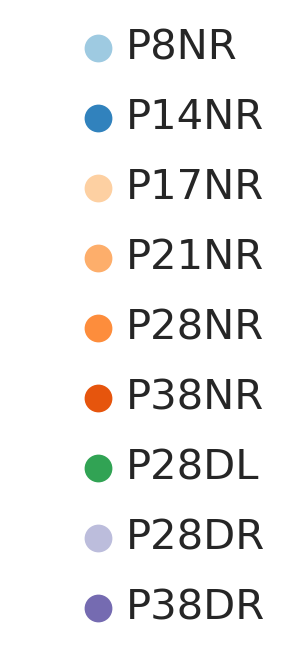

In [16]:
fig, ax = plt.subplots(figsize=(1,4))
for i, (key, item) in enumerate(palette.items()):
    ax.plot(0,     len(palette)-i, 'o', c=item, )
    ax.text(0.02,  len(palette)-i, key, va='center', fontsize=15)
    ax.axis('off')
plt.show()

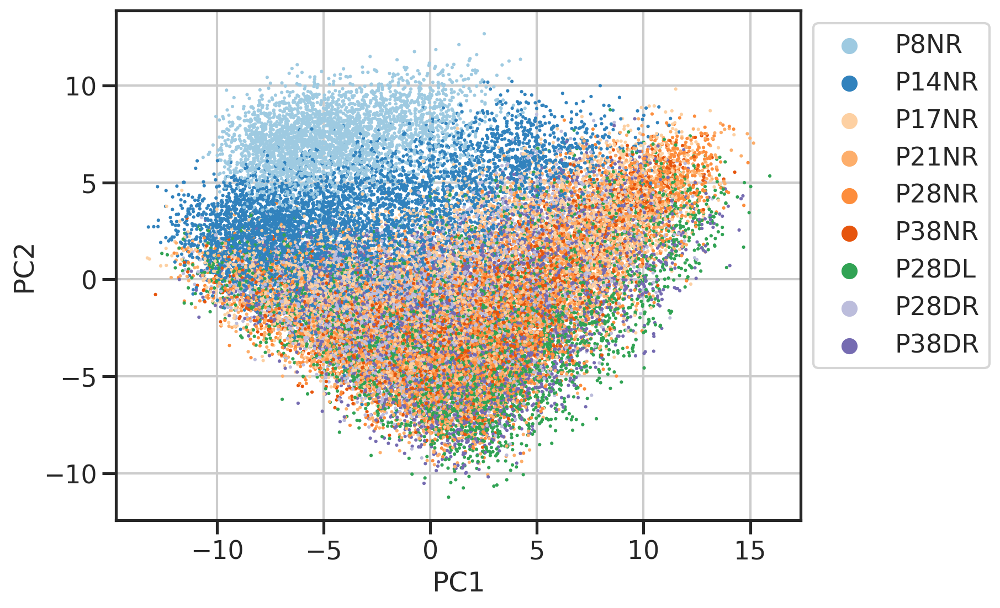

In [17]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC1', y='PC2', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

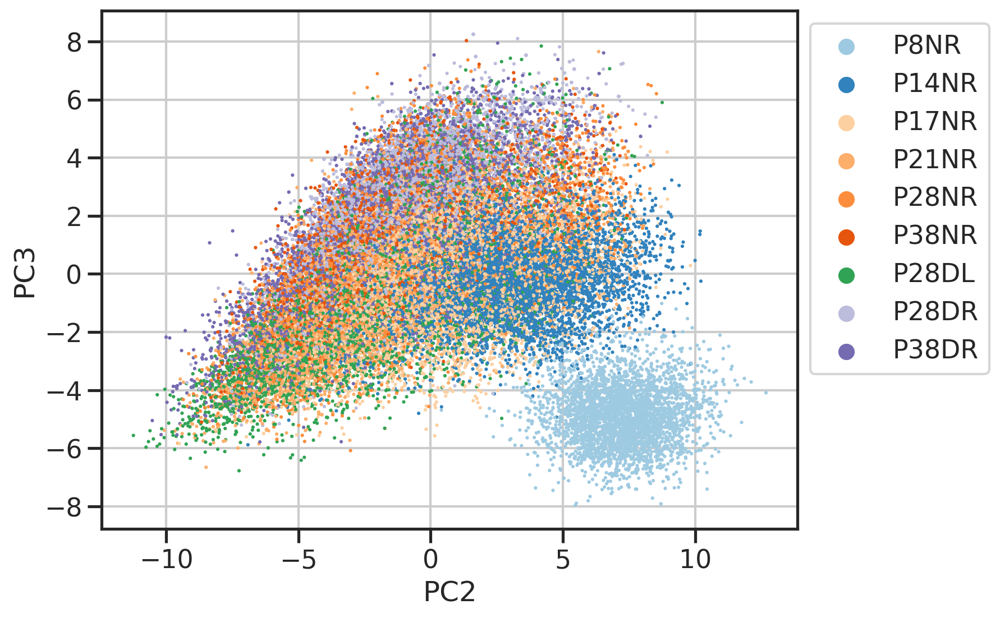

In [18]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC2', y='PC3', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

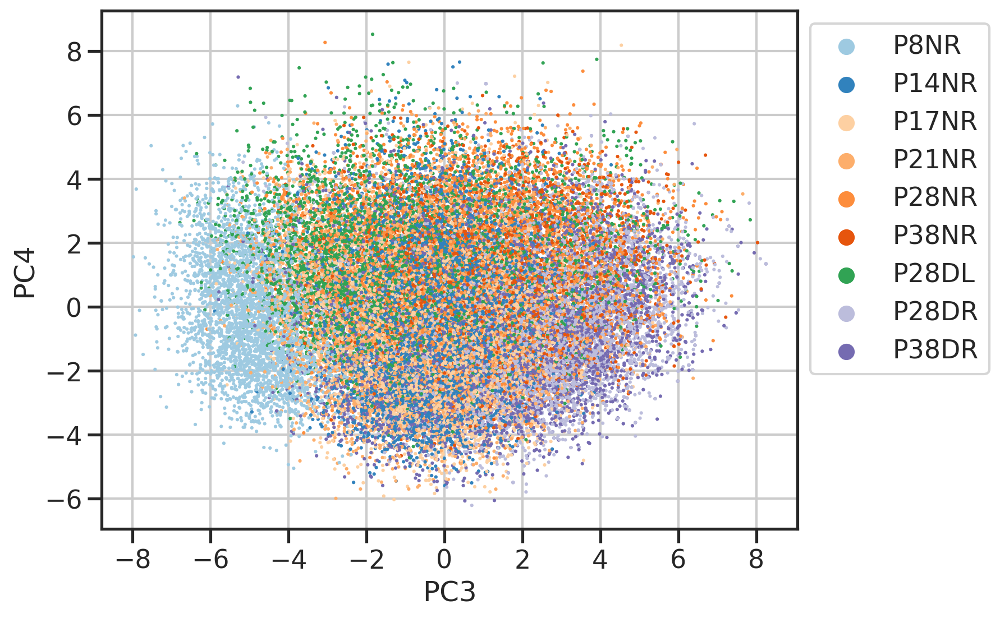

In [19]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='PC3', y='PC4', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

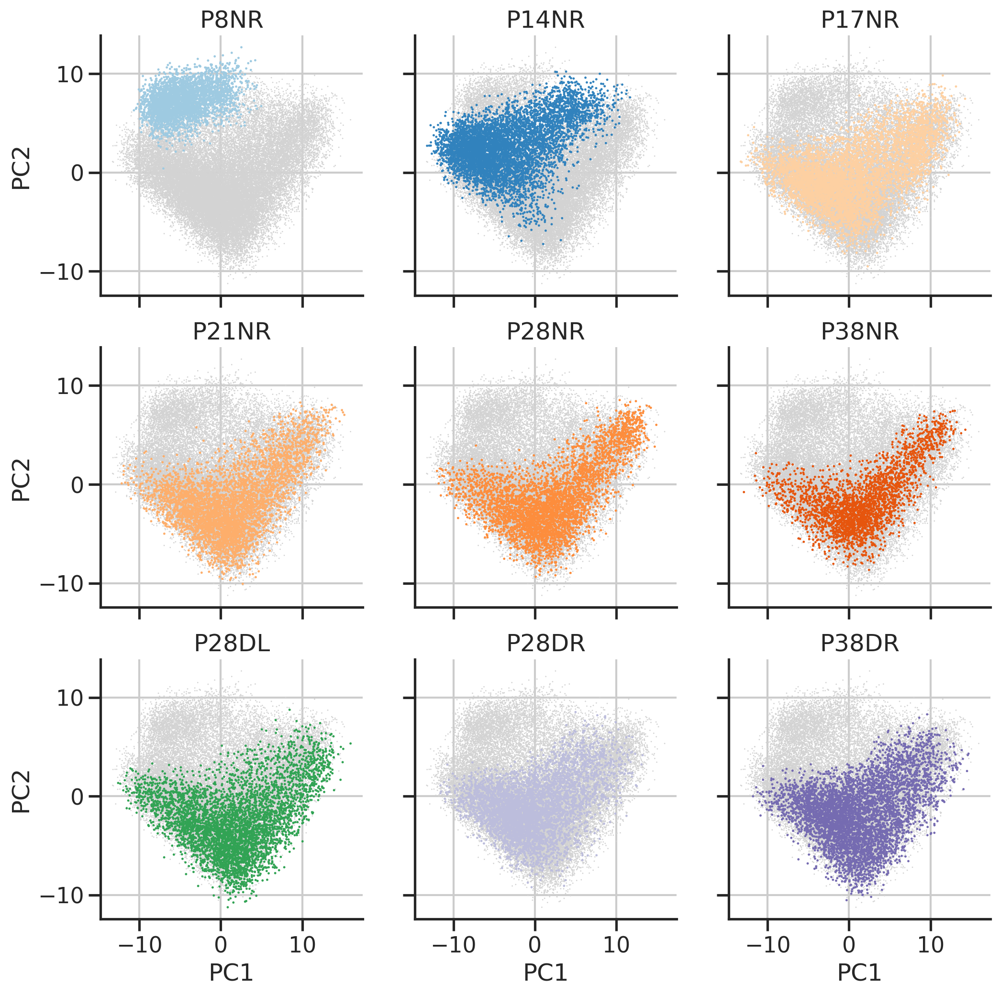

In [20]:
fig, axs = plt.subplots(3,3,figsize=(4*3,4*3), sharex=True, sharey=True)
for ax, cond in zip(axs.flat, cases):
    ax.set_title(cond)
    sns.scatterplot(data=res, 
                    x='PC1', y='PC2', 
                    c='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond']==cond],
                    x='PC1', y='PC2', 
                    hue='cond',
                    hue_order=list(palette.keys()),
                    palette=palette,
                    s=3, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.despine(ax=ax)
plt.show()

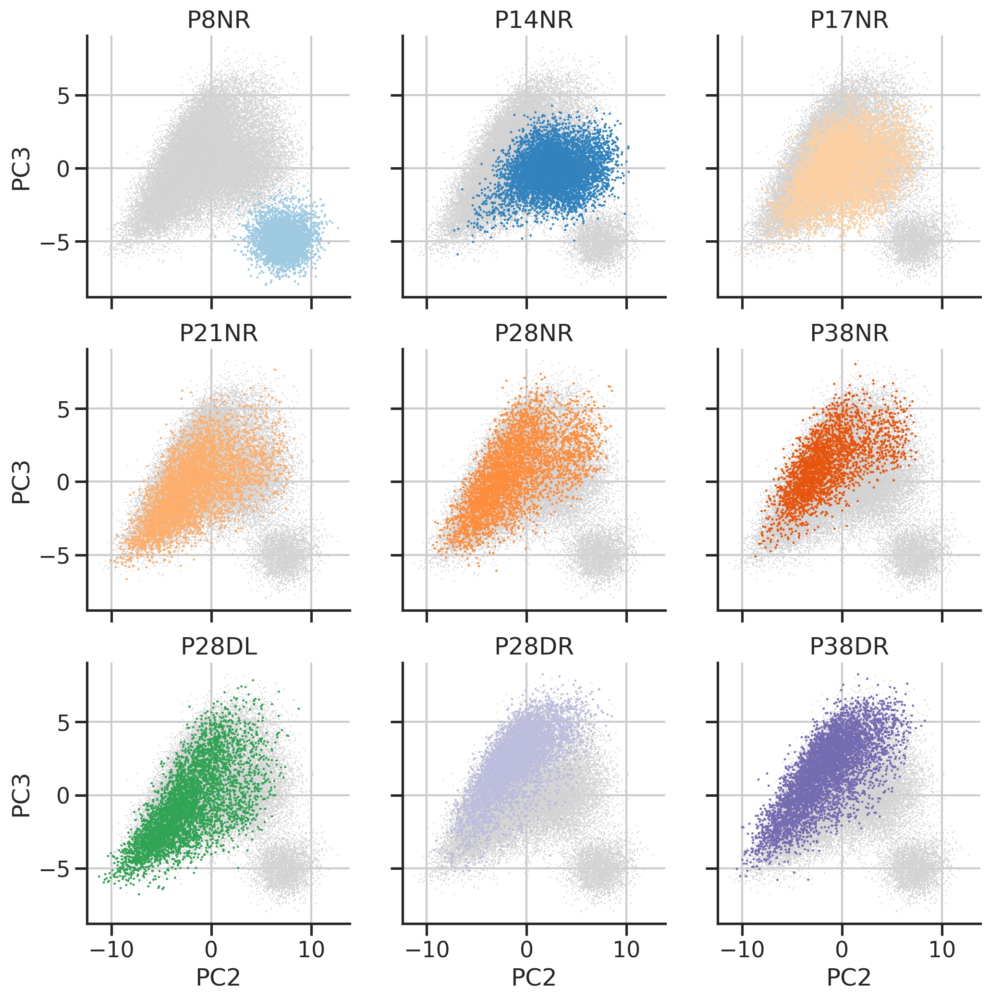

In [21]:
fig, axs = plt.subplots(3,3,figsize=(4*3,4*3), sharex=True, sharey=True)
for ax, cond in zip(axs.flat, cases):
    ax.set_title(cond)
    sns.scatterplot(data=res, 
                    x='PC2', y='PC3', 
                    c='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond']==cond],
                    x='PC2', y='PC3', 
                    hue='cond',
                    hue_order=list(palette.keys()),
                    palette=palette,
                    s=3, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.despine(ax=ax)
plt.show()

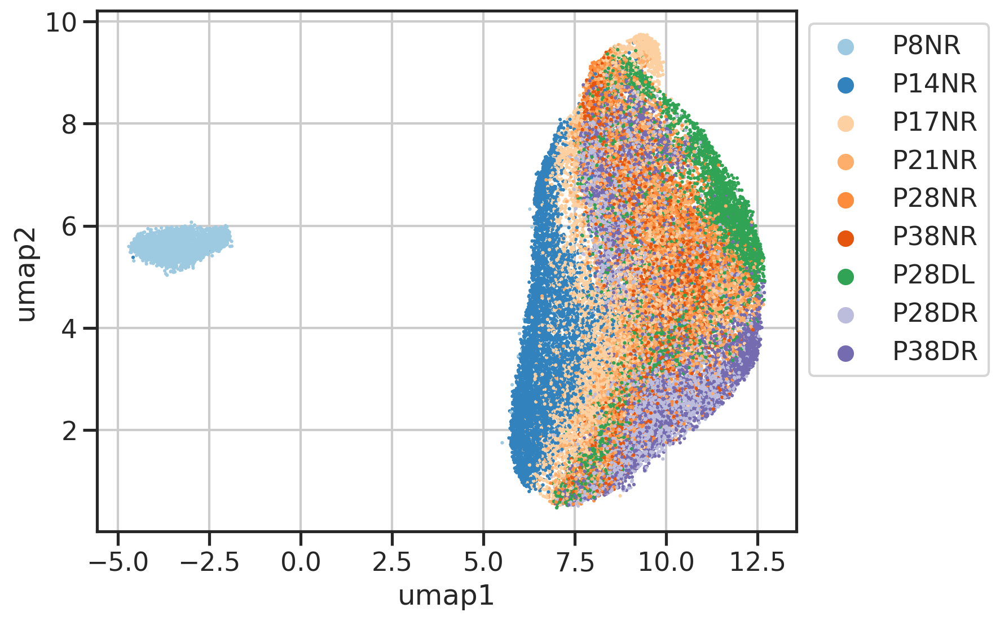

In [22]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='cond',
                hue_order=list(palette.keys()),
                palette=palette,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

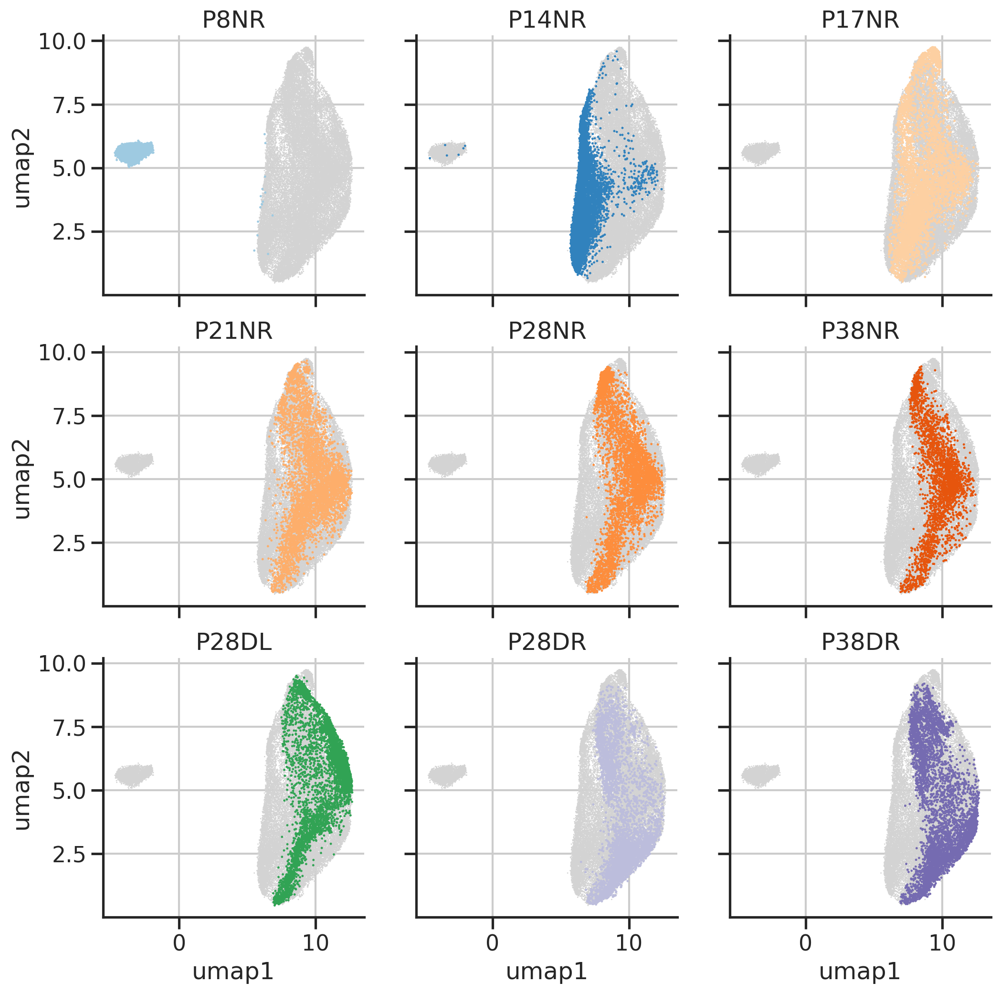

In [23]:
fig, axs = plt.subplots(3,3,figsize=(4*3,4*3), sharex=True, sharey=True)
for ax, cond in zip(axs.flat, cases):
    ax.set_title(cond)
    sns.scatterplot(data=res, 
                    x='umap1', y='umap2', 
                    c='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond']==cond],
                    x='umap1', y='umap2', 
                    hue='cond',
                    hue_order=list(palette.keys()),
                    palette=palette,
                    s=3, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.despine(ax=ax)
plt.show()

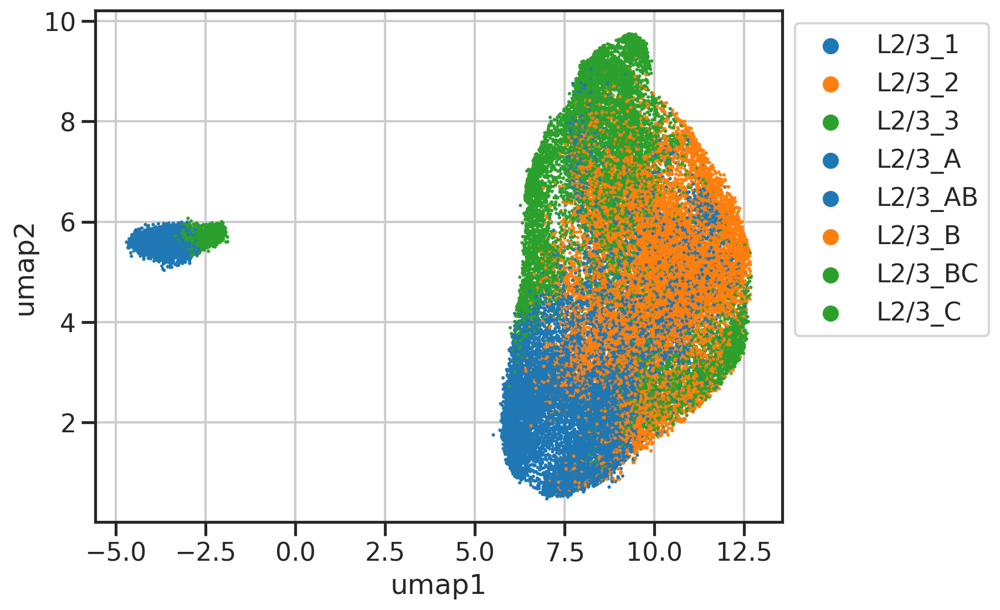

In [24]:
fig, ax = plt.subplots(1,1,figsize=(8*1,6))
sns.scatterplot(data=res.sample(frac=1, replace=False), 
                x='umap1', y='umap2', 
                hue='type',
                # hue='cond',
                # hue_order=list(palette.keys()),
                palette=palette_types,
                s=5, edgecolor='none', 
                # legend=False,
                ax=ax,
               )
ax.legend(bbox_to_anchor=(1,1))
plt.show()

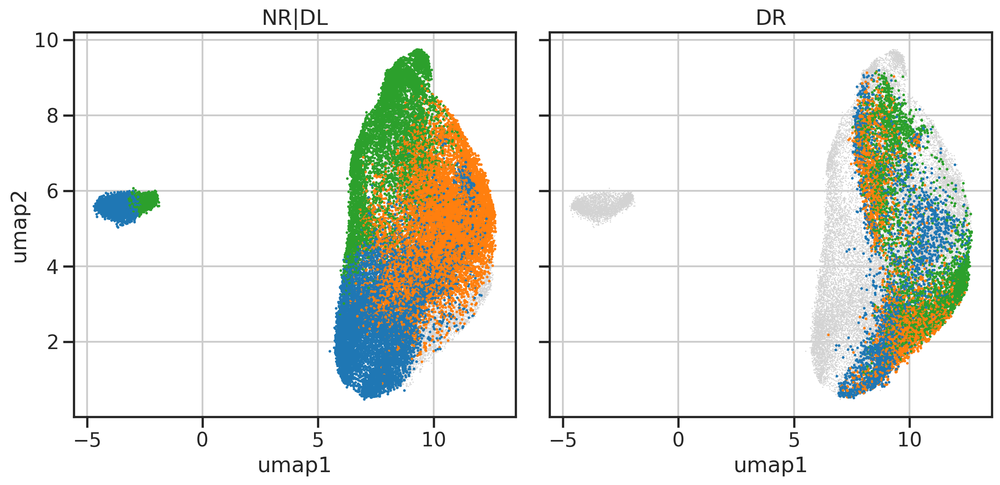

In [25]:
fig, axs = plt.subplots(1,2,figsize=(6*2,6), sharex=True, sharey=True)
categories = ['NR|DL', 'DR']
for cat, ax in zip(categories, axs.flat):
    ax.set_title(cat)
    sns.scatterplot(data=res, #[res['cond'].str.contains('DR')].sample(frac=1, replace=False), 
                    x='umap1', y='umap2', 
                    color='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond'].str.contains(cat)].sample(frac=1, replace=False), 
                    x='umap1', y='umap2', 
                    hue='type',
                    palette=palette_types,
                    s=5, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
# ax.legend(bbox_to_anchor=(1,1))
fig.tight_layout()
plt.show()

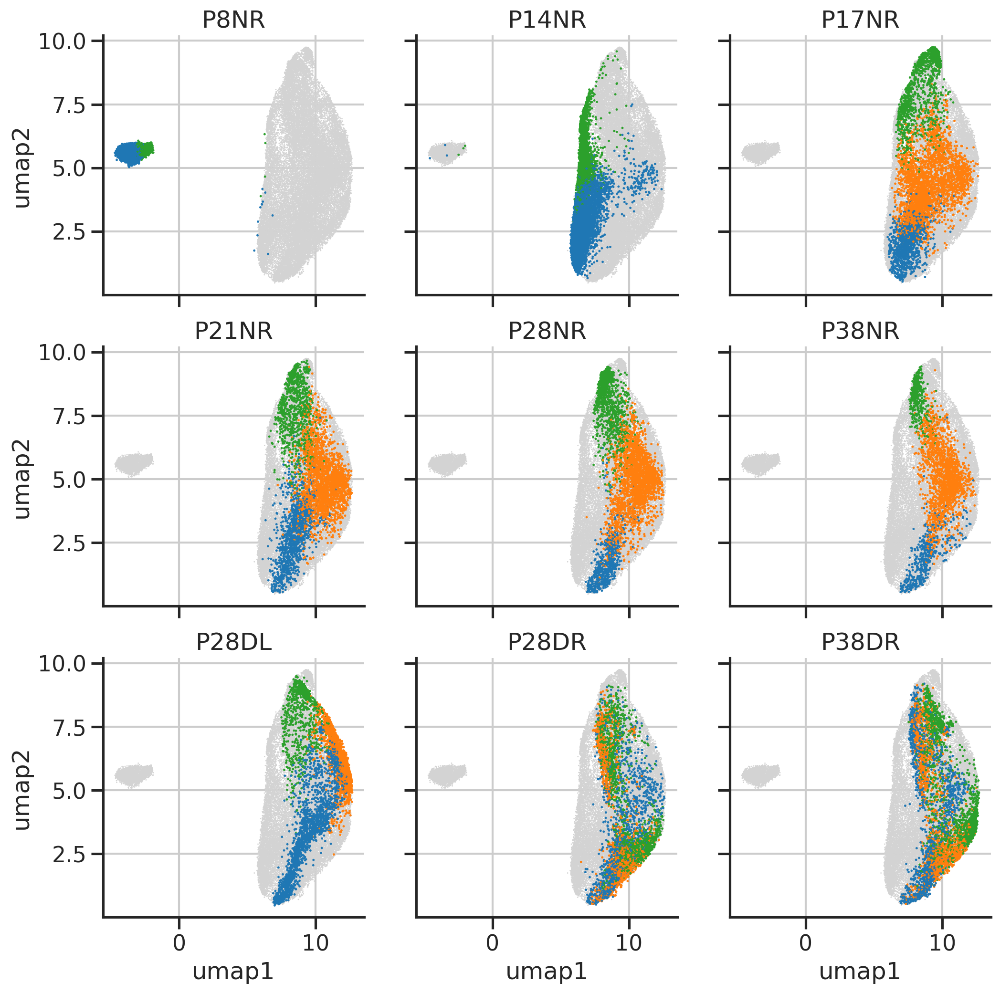

In [26]:
fig, axs = plt.subplots(3,3,figsize=(4*3,4*3), sharex=True, sharey=True)
for ax, cond in zip(axs.flat, cases):
    ax.set_title(cond)
    sns.scatterplot(data=res, 
                    x='umap1', y='umap2', 
                    c='lightgray',
                    s=1, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.scatterplot(data=res[res['cond']==cond],
                    x='umap1', y='umap2', 
                    hue='type',
                    # hue_order=list(palette.keys()),
                    palette=palette_types,
                    s=3, edgecolor='none', 
                    legend=False,
                    ax=ax,
                   )
    sns.despine(ax=ax)
plt.show()

# heatmap

# give each cell a pseudo-time index

In [27]:
ncell, ngene = zlognorm.shape

my_colors = ('C0', 'C1', 'C2')
cmap_d1 = LinearSegmentedColormap.from_list('', my_colors, len(my_colors))

my_colors = ('C0', 'C1', 'C2', 'C3')
cmap_d2 = LinearSegmentedColormap.from_list('', my_colors, len(my_colors))

In [28]:
# Use P28 ordering
f = '../../results/gene_ptime_P28_L23_Mar27.tsv'
gpt = pd.read_csv(f)
gpt = gpt['gene_ptime'].values
geneidx = np.argsort(gpt)

In [29]:
# Use ptime from each sample analysis
dfall = []
for case in cases:
    f = f'../../results/cell_ptime_{case}_L23_Mar28.tsv'
    df = pd.read_csv(f, index_col=0)
    df['case'] = case
    dfall.append(df)
dfall = pd.concat(dfall)
assert np.all(dfall.index.values == adata.obs.index.values)
dfall

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC47,PC48,PC49,PC50,type,samp,umap1,umap2,ptime,case
AAACGCTCACTTCATT-1-P8_1a-P8,-4.167515,0.169273,2.574383,-1.589666,2.923386,-0.120249,-1.950705,-1.732618,-1.321194,0.659689,...,0.554465,-0.936461,0.380486,-0.015368,L2/3_AB,P8_1a,10.371646,3.036468,0.276353,P8NR
AAAGGATAGGTGCATG-1-P8_1a-P8,-5.710969,2.632143,-3.127635,2.985007,0.406603,-0.940489,0.612224,2.176416,-0.839287,3.160024,...,0.050299,-1.374758,-1.108813,-0.809501,L2/3_AB,P8_1a,11.195108,2.691917,0.170780,P8NR
AAAGGGCCAGTATACC-1-P8_1a-P8,0.363032,-1.037412,-2.000788,-1.303415,0.173461,-1.057998,-0.028259,-0.368191,0.805563,0.139518,...,-0.068263,-0.248844,-0.860799,0.422525,L2/3_AB,P8_1a,7.659028,1.148404,0.426782,P8NR
AAAGTCCCATATACCG-1-P8_1a-P8,0.603333,-1.386780,-2.359930,-2.483881,0.671093,0.319811,3.409799,-0.692306,0.300376,-0.038912,...,-0.238657,-0.449361,0.308295,0.059158,L2/3_AB,P8_1a,7.774300,1.742997,0.425401,P8NR
AAAGTCCTCAGATGCT-1-P8_1a-P8,6.168784,3.406447,-1.801495,-2.772495,0.837046,-1.310614,-1.121606,1.146195,-1.539873,-2.078232,...,-3.319709,-1.509901,-1.380832,0.662135,L2/3_BC,P8_1a,4.717086,1.385406,0.625315,P8NR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAGTTGTTG-1-P38_dr_1a,1.603376,2.800474,1.054118,-2.621499,1.496856,3.133421,-0.524684,1.361778,-0.675490,-1.652105,...,0.693891,0.494570,0.283097,-0.610193,L2/3_3,P38_dr_1a,7.627140,2.115497,0.545054,P38DR
TTTGGTTTCTGCCTGT-1-P38_dr_2b,-3.830772,7.694133,-0.449819,2.001263,1.363460,-3.604184,2.277025,2.689968,-1.778446,1.101287,...,0.812298,1.058447,0.135438,-0.950600,L2/3_3,P38_dr_2b,9.046733,0.693446,0.562204,P38DR
TTTGTTGCACCGGTCA-1-P38_dr_2a,-2.635137,4.027407,-1.084643,1.620008,-0.744443,-0.695006,0.090084,3.042968,-0.855017,-1.101044,...,-1.234141,0.170709,0.457045,0.846405,L2/3_3,P38_dr_2a,9.125484,1.713715,0.498568,P38DR
TTTGTTGGTGGCTAGA-1-P38_dr_2b,-1.907812,0.440405,-0.632879,0.026408,-1.893107,-2.452266,-0.529140,-0.347105,0.620726,0.776882,...,0.859818,0.117613,-0.129171,-0.410174,L2/3_2,P38_dr_2b,9.331425,3.539268,0.478478,P38DR


In [30]:
def plot(zlognorm, cellidx, geneidx, types, genes_grp, case, figsize=(12,6), xticklabels=1000, hratio=20, vratio=10):
    """
    """
    mosaic = ("B"+"A"*hratio+"\n")*vratio + "."+"C"*hratio
    # print(mosaic)
    fig, axdict = plt.subplot_mosaic(mosaic, figsize=figsize)
    fig.suptitle(case)
    ax = axdict['A']
    sns.heatmap(zlognorm[cellidx][:,geneidx].T,
                xticklabels=False,
                yticklabels=False,
                cbar_kws=dict(shrink=0.3, label='zscore log10CP10k', aspect=10),
                center=0,
                vmax=3,
                vmin=-3,
                cmap='coolwarm',
                rasterized=True,
                ax=ax,
               )

    ax = axdict['C']
    sns.heatmap(pd.factorize(types[cellidx], sort=True)[0].reshape(-1,1).T, 
                xticklabels=xticklabels,
                yticklabels=False,
                cmap=cmap_d1,
                cbar_kws=dict(ticks=[0,1,2], shrink=2, aspect=5),
                rasterized=True,
                ax=ax, 
               )
    ax.set_xlabel('Cells')
    fig.axes[-1].set_yticklabels(['A','B','C'])
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

    ax = axdict['B']
    sns.heatmap(pd.factorize(genes_grp[geneidx], sort=True)[0].reshape(-1,1), 
                xticklabels=False,
                yticklabels=100,
                cmap=cmap_d1,
                cbar=False,
                rasterized=True,
                ax=ax, 
               )
    ax.set_ylabel('Genes')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=10)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, fontsize=10)

    fig.subplots_adjust(hspace=0.4)
    return fig, axdict
    # fig.suptitle(sample)
    # powerplots.savefig_autodate(fig, os.path.join(outdir_fig, f'heatmap_{sample}_v3.pdf'))
    # plt.show()

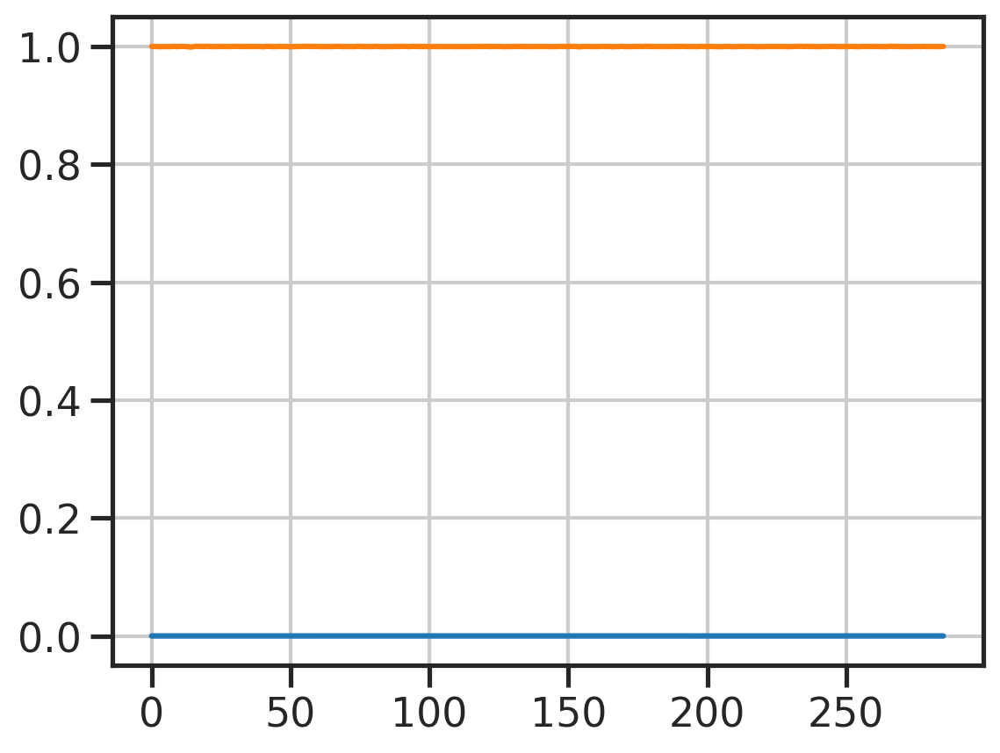

In [31]:
plt.plot(zlognorm.mean(axis=0))
plt.plot(zlognorm.std(axis=0))

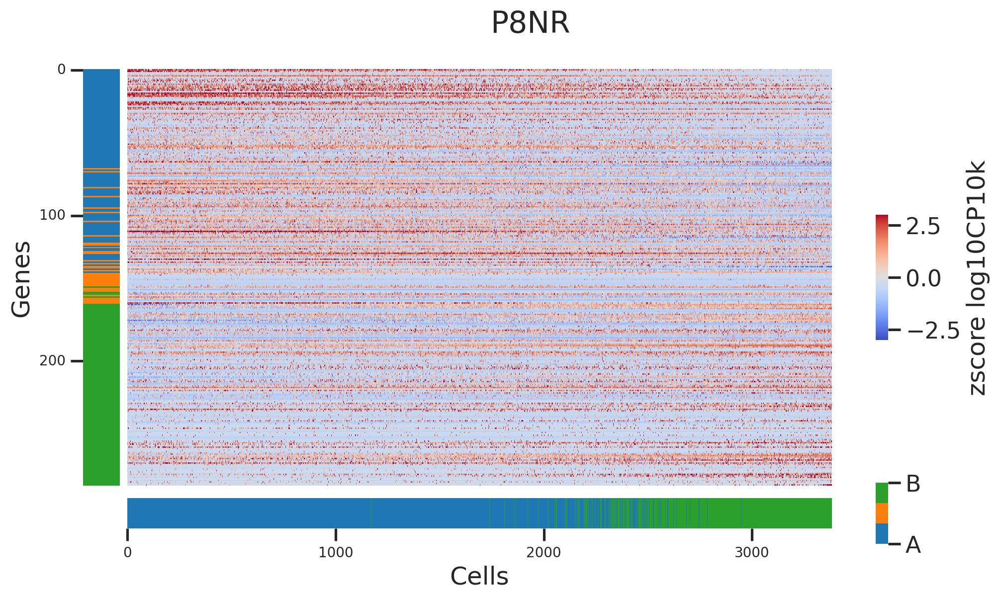

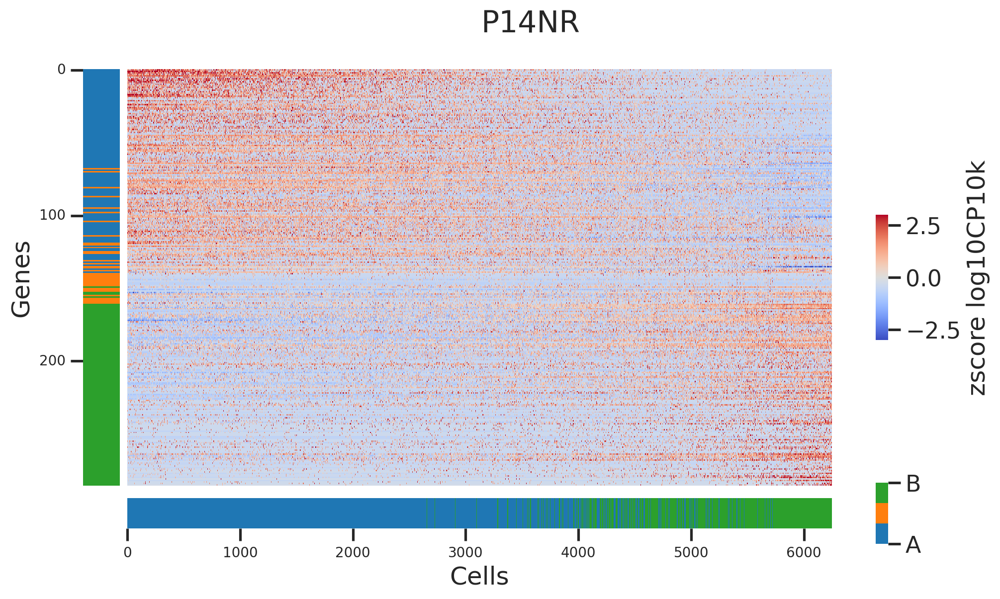

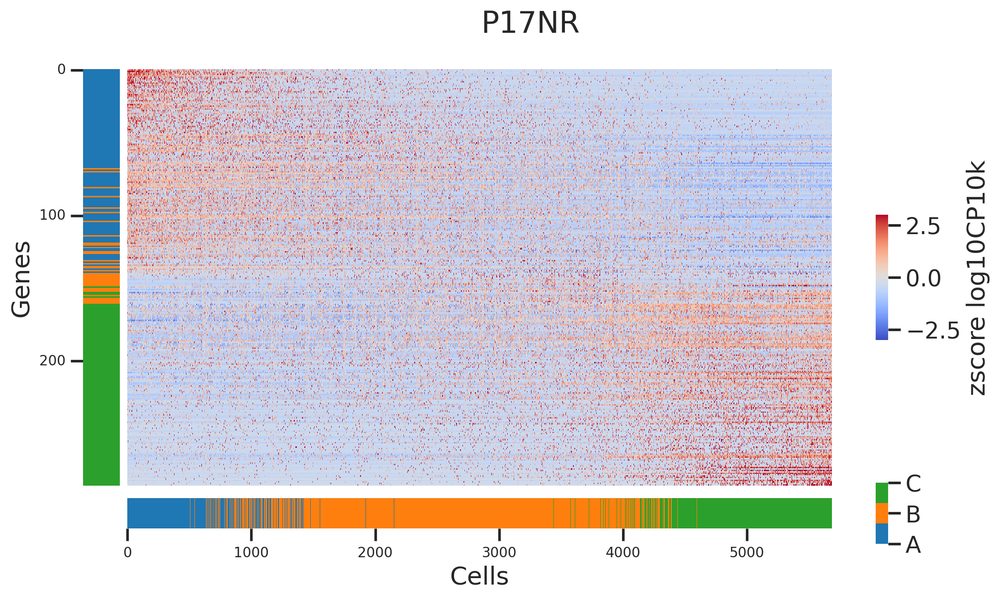

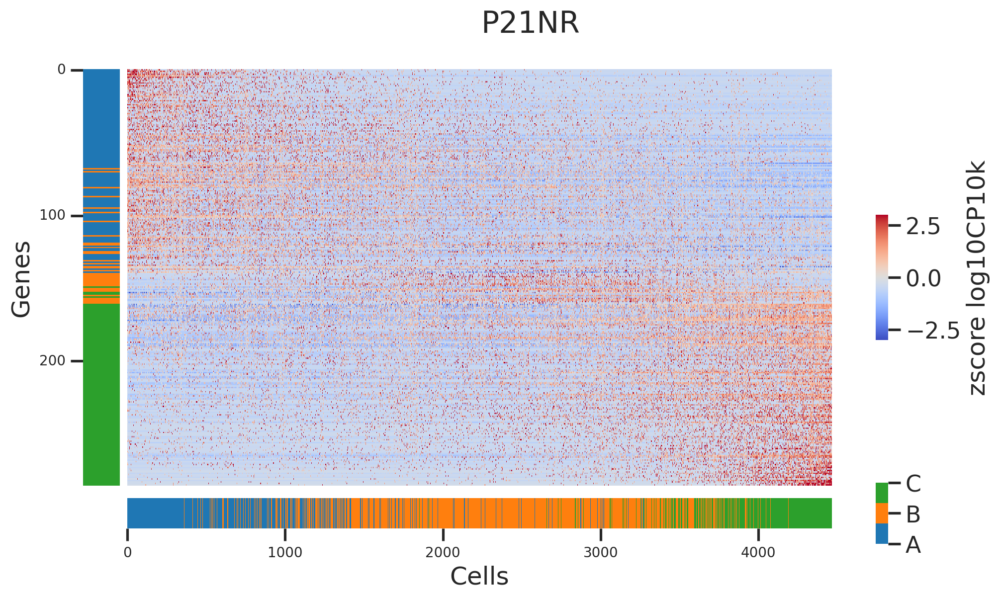

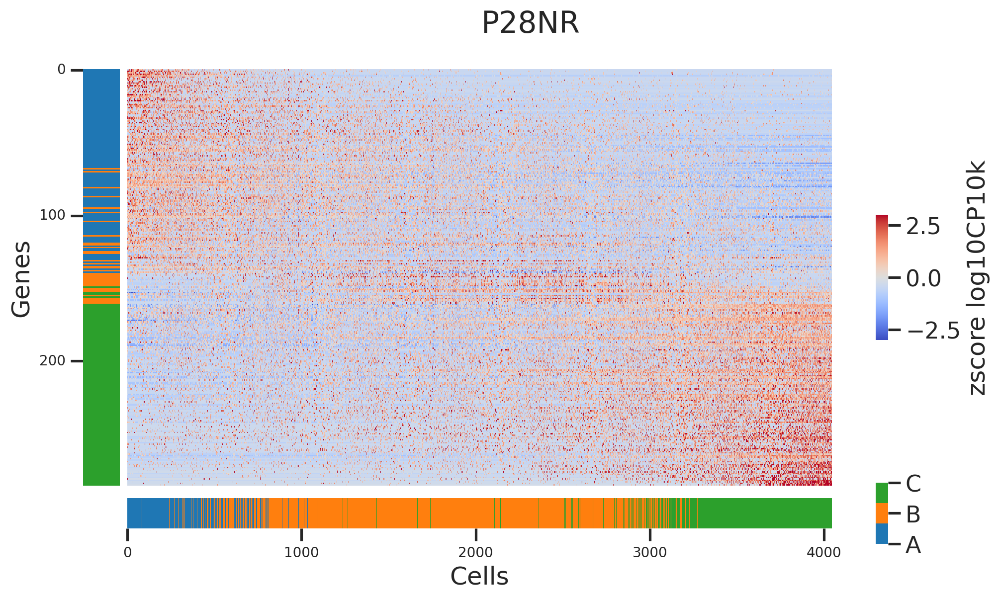

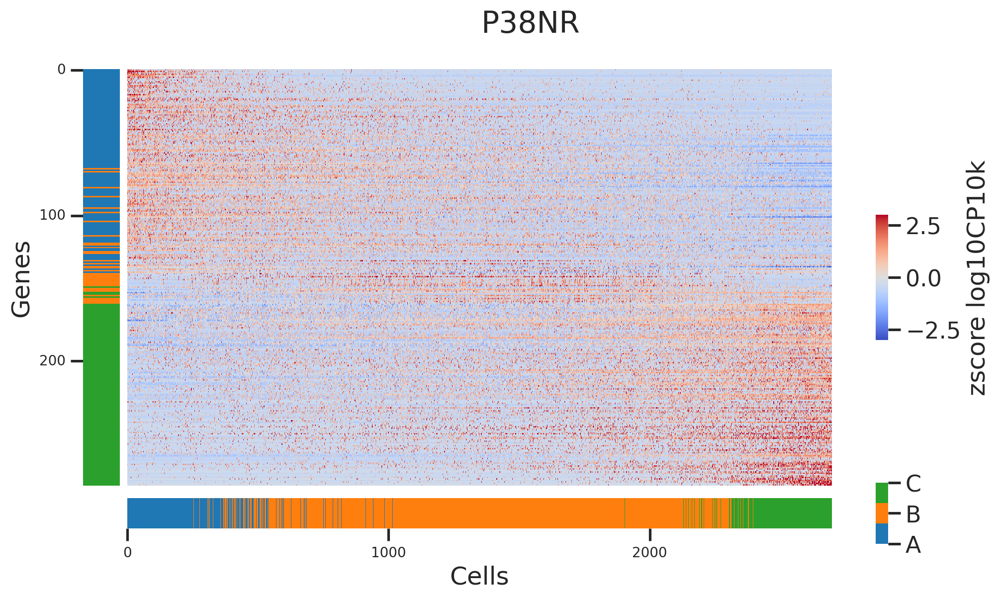

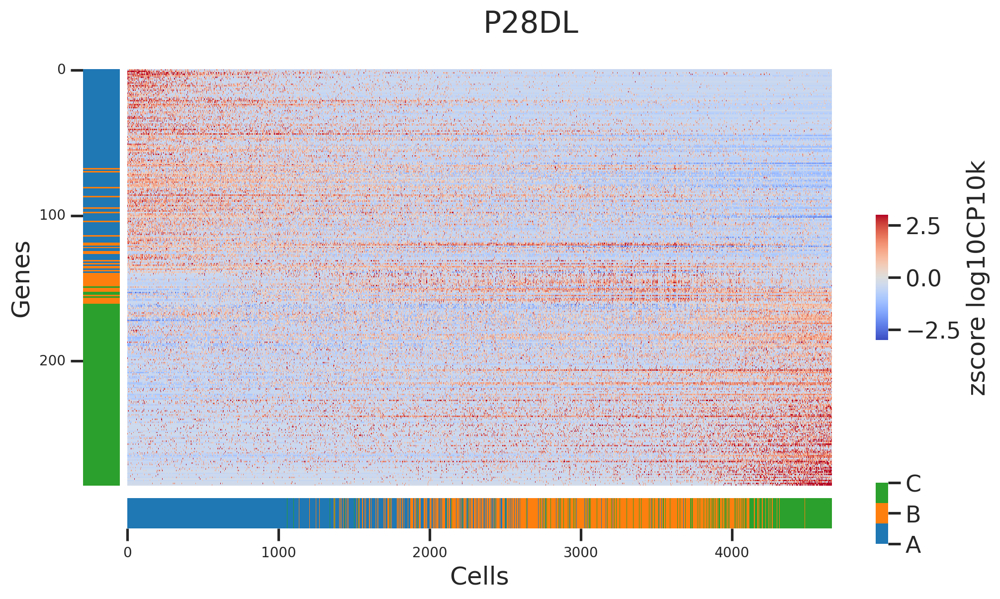

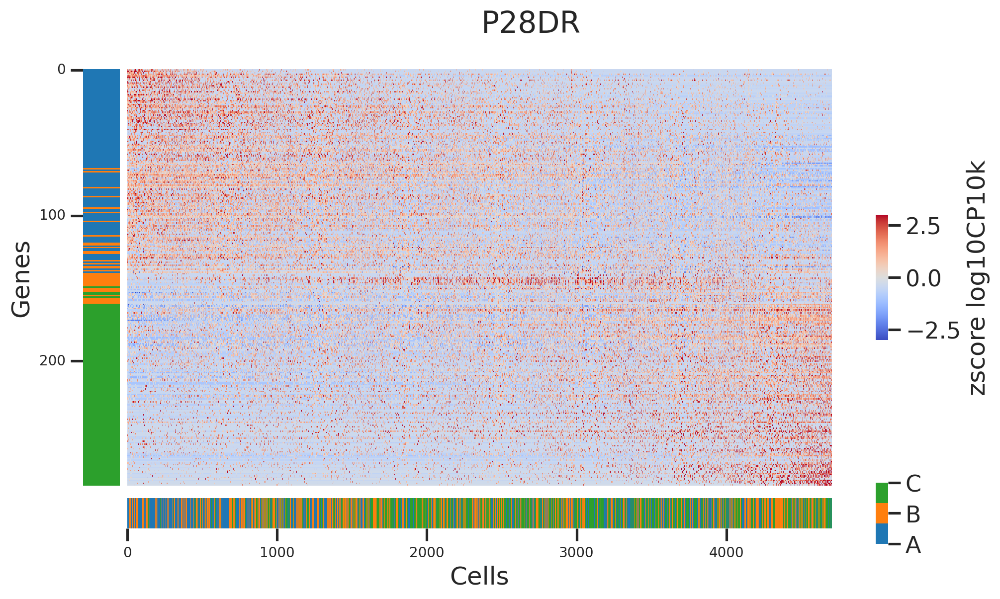

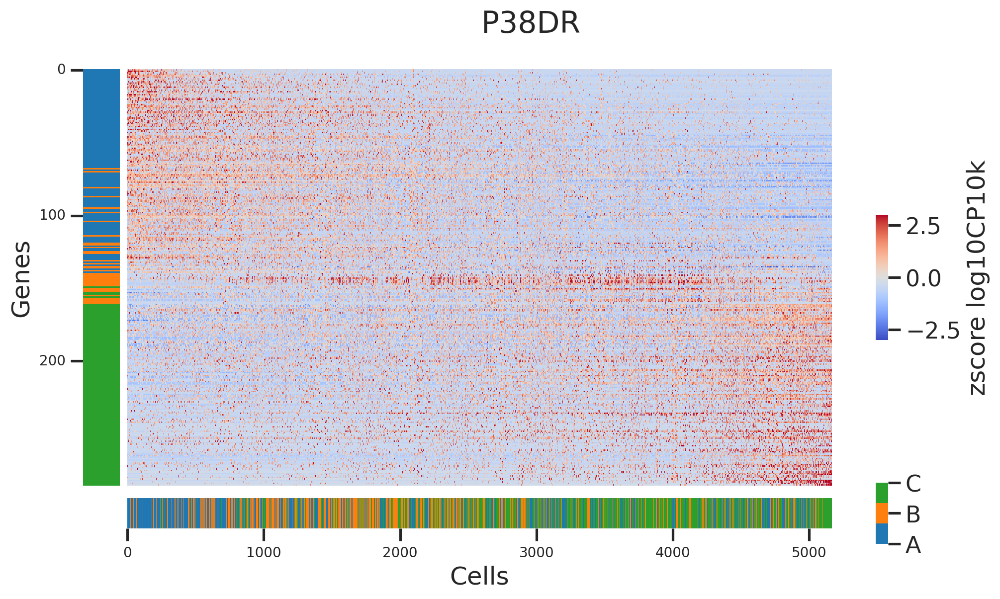

In [32]:
allcells = adata.obs.index.values
mean_exps = []
rnge_exps = []
for case in cases:
    
    # select cells
    adata_sub = adata[adata.obs['cond']==case]
    cells_sub = adata_sub.obs.index.values
    cellsidx_sub = basicu.get_index_from_array(allcells, cells_sub)
    
    dfall_sub = dfall.loc[cells_sub]
    zlognorm_sub = zlognorm[cellsidx_sub]
    
    # order cells
    cellidx = np.argsort(dfall_sub['ptime'].values)
    types   = adata_sub.obs['Type'].values
    
    mean_exp = zlognorm_sub.mean(axis=0)
    rnge_exp = np.percentile(zlognorm_sub, 95, axis=0) - np.percentile(zlognorm_sub, 5, axis=0)
    mean_exps.append(mean_exp)
    rnge_exps.append(rnge_exp)
    plot(zlognorm_sub, cellidx, geneidx, types, genes_grp, case)
    
    # break

In [33]:
# a big table of everything
allcells = adata.obs.index.values
bigmat = []
bigtypes = []

ncases = []
for case in cases:
    # select cells
    adata_sub = adata[adata.obs['cond']==case]
    cells_sub = adata_sub.obs.index.values
    cellsidx_sub = basicu.get_index_from_array(allcells, cells_sub)
    
    dfall_sub = dfall.loc[cells_sub]
    zlognorm_sub = zlognorm[cellsidx_sub]
    
    # order cells
    cellidx = np.argsort(dfall_sub['ptime'].values)
    types   = adata_sub.obs['easitype'].values
    
    bigmat.append(zlognorm_sub[cellidx])
    bigtypes.append(types[cellidx])
    ncases.append(len(cellidx))
    
bigmat = np.vstack(bigmat)
bigtypes = np.hstack(bigtypes)
bigmat.shape

(41048, 286)

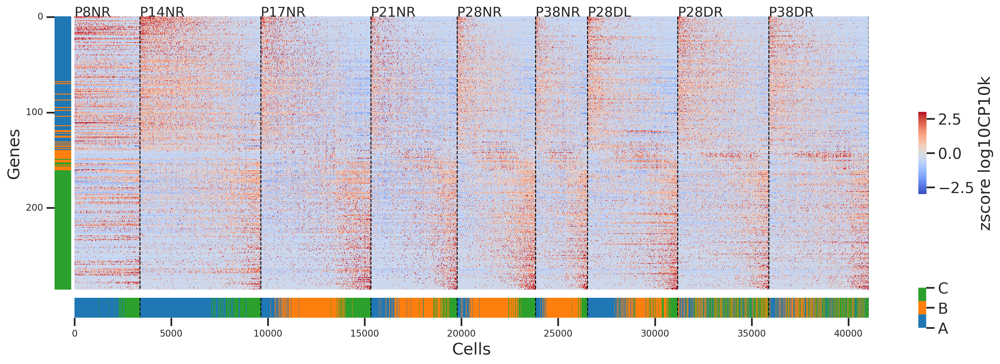

In [34]:
fig, axdict = plot(bigmat, np.arange(len(bigmat)), geneidx, bigtypes, genes_grp, "", 
                   figsize=(20,6), xticklabels=5000, hratio=50)
axdict['A'].vlines(np.cumsum(ncases), 0, bigmat.shape[1], color='k', linestyle='--', linewidth=1)
axdict['C'].vlines(np.cumsum(ncases), 0, 1, color='k', linestyle='--', linewidth=1)
for x, case in zip(np.hstack([[0], np.cumsum(ncases)]), cases):
    axdict['A'].text(x, 0, case, fontsize=15)
plt.show()

# Collapse into types

# Specific genes

# Quantify this